In [1]:
import torch, torchvision
import matplotlib.pyplot as plt
import numpy as np

def ishow(x,vmin=0.0, vmax=1.0):
    plt.imshow(x.permute(1, 2, 0),vmin=vmin, vmax=vmax)
    plt.axis('off')
    plt.show()

In [2]:
image = torchvision.io.read_image('public/mandrill.png')/255.
N=20
bimage = image.unsqueeze(0).expand(N,-1,-1,-1)

In [33]:

import math


def rigid_transform(image, scale_alpha, trans_x, trans_y, rot_beta):
    # Apply a rigid (geometric) transform: scale, translation, rotation via bilinear interpolation
    N,_,H,W = image.shape
    coords = torch.stack(torch.meshgrid(torch.linspace(-1, 1, H), torch.linspace(-1, 1, W),indexing='xy') )
    cos_b = torch.cos(rot_beta/180 *torch.pi)
    sin_b = torch.sin(rot_beta/180 *torch.pi)
    coords_transf = torch.einsum("bcd,dl->bcl", (torch.stack([
    torch.stack([scale_alpha * cos_b, scale_alpha * sin_b, -trans_x/(W/2)], dim=-1),
    torch.stack([-scale_alpha * sin_b, scale_alpha * cos_b, -trans_y/(H/2)], dim=-1),
    torch.tensor([0., 0., 1.]).expand(N, -1)
], dim=1),torch.stack([*coords.flatten(-2),torch.ones(H*W)])))[:,:2].reshape(N,2, H, W).moveaxis(1,-1)
    return torch.nn.functional.grid_sample(
        image,
        coords_transf,
        mode='bilinear',
        align_corners=True,
    )
    
def highpass_kernel(shape):
    result = torch.outer(torch.blackman_window(shape[0]), torch.blackman_window(shape[1]))
    return torch.abs(result - torch.max(result)).unsqueeze(0).unsqueeze(0)


def get_radius(H,W):
    y_center, x_center =W/ 2, H / 2
    return math.sqrt(y_center ** 2 + x_center ** 2),x_center, y_center 

def cart2pol(img):
    radius,x_center,y_center  = get_radius(*img.shape[-2:])
    theta, r = torch.meshgrid(*[torch.arange(360),torch.arange( int(radius))])
    rho = radius ** (r / radius)
    theta_rad = theta * torch.pi / 180
    y_indices = rho * torch.sin(theta_rad) + y_center
    x_indices = rho * torch.cos(theta_rad) + x_center
    grid = torch.stack([(x_indices / (img.shape[-2] - 1)) * 2 - 1, (y_indices / (img.shape[-1] - 1)) * 2 - 1], axis=-1)
    sampled = torch.nn.functional.grid_sample(
        img, grid.clamp(-1,1).unsqueeze(0).expand(img.size(0),*3*[-1]), mode='bilinear', align_corners=True
    )
    return sampled


def fft2d(img):
    return torch.fft.fftshift(torch.fft.fft2(img))

def apply_highpass(img, high_pass_kernel):
    return img.abs() * high_pass_kernel
    
def estimate_rot_scale_parameters(phase_correlation, radius):
    posMaxs = phase_correlation.flatten(-2).argmax(-1).float()
    posMax2d =torch.dstack([posMaxs // phase_correlation.size(-1),posMaxs % phase_correlation.size(-1)]).mean(-2).round().long()
    ty, tx = (posMax2d - (torch.tensor(phase_correlation.shape[-2:]) // 2).unsqueeze(0)).moveaxis(0,-1)
    estScale = radius ** (-tx / radius)
    estAmbiguousAngle = -ty
    return estScale,estAmbiguousAngle


def inverse_rot_scale_parameters(estScale, estAngle):
    return 1/estScale,-estAngle

def phase_correlation(f, g):
    F_f = torch.fft.rfft2(f)
    F_g = torch.fft.rfft2(g)
    R = F_f * torch.conj(F_g)
    R /= torch.abs(R)
    r = torch.fft.irfft2(R)
    return torch.fft.ifftshift(r)

def bphase_correlation(f, g):
    F_f = torch.fft.fft2(f)
    F_g = torch.fft.fft2(g)
    R = F_f * torch.conj(F_g)
    R /= torch.abs(R)
    r = torch.fft.ifft2(R)
    return r

def estimate_all_parameters(pc,x_center, y_center ,estScale, estAmbiguousAngle):
    bestCandidateArgmax = pc.flatten(-2).argmax(-1)
    bestCandidateIdx2d = torch.stack([bestCandidateArgmax//pc.size(-1),bestCandidateArgmax%pc.size(-1)])
    return torch.stack([*(((bestCandidateIdx2d-torch.tensor([x_center, y_center]).unsqueeze(-1)))), estScale,estAmbiguousAngle,(180+estAmbiguousAngle)%360], axis=-1)


In [34]:
bhp  =highpass_kernel(bimage.shape[-2:])
radius,x_center,y_center  = get_radius(*bimage.shape[-2:])

Estimated Parameters tensor([[  1.0000, -25.0000,   1.2356, -89.0000,  91.0000],
        [  0.0000, -26.0000,   0.9070, -80.0000, 100.0000],
        [159.0000,  13.0000,   1.0331, -70.0000, 110.0000],
        [  1.0000, -26.0000,   1.4778, -61.0000, 119.0000],
        [  0.0000, -25.0000,   0.8093, -51.0000, 129.0000],
        [  2.0000, -25.0000,   0.5048, -42.0000, 138.0000],
        [  0.0000, -26.0000,   1.0331, -32.0000, 148.0000],
        [  0.0000, -25.0000,   1.2356, -23.0000, 157.0000],
        [ -1.0000, -23.0000,   1.0331, -14.0000, 166.0000],
        [  0.0000, -25.0000,   1.3623,  -4.0000, 176.0000],
        [  1.0000, -24.0000,   0.6550,   5.0000, 185.0000],
        [  0.0000, -23.0000,   1.0000,  15.0000, 195.0000],
        [ -1.0000, -25.0000,   0.6444,  46.0000, 226.0000],
        [ -2.0000, -25.0000,   0.7105,  33.0000, 213.0000],
        [  0.0000, -26.0000,   1.4540,  43.0000, 223.0000],
        [  0.0000, -25.0000,   0.8226,  52.0000, 232.0000],
        [  0.0000, 

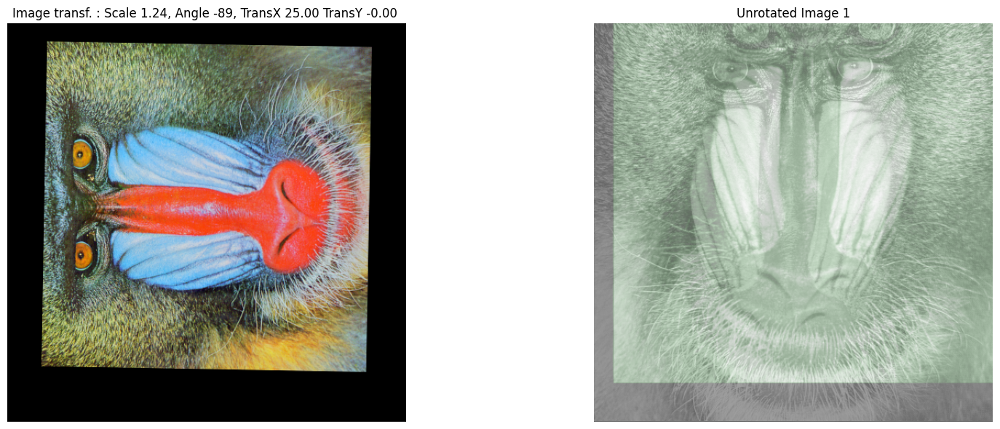

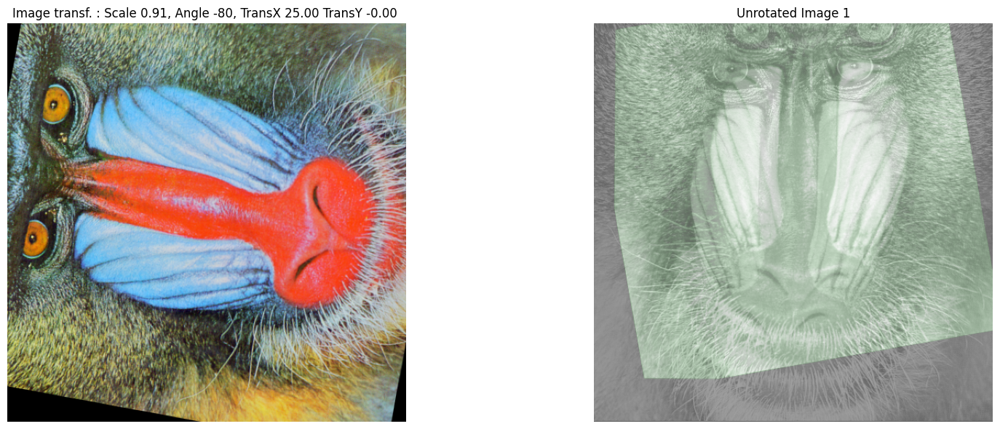

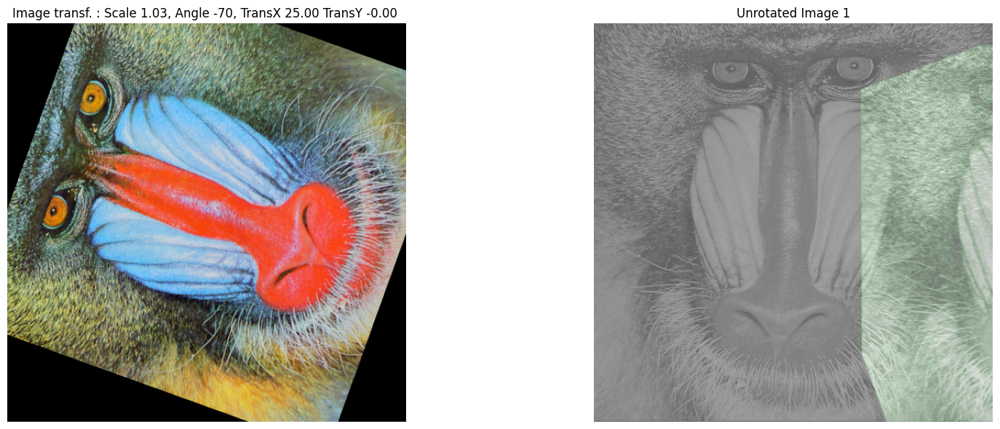

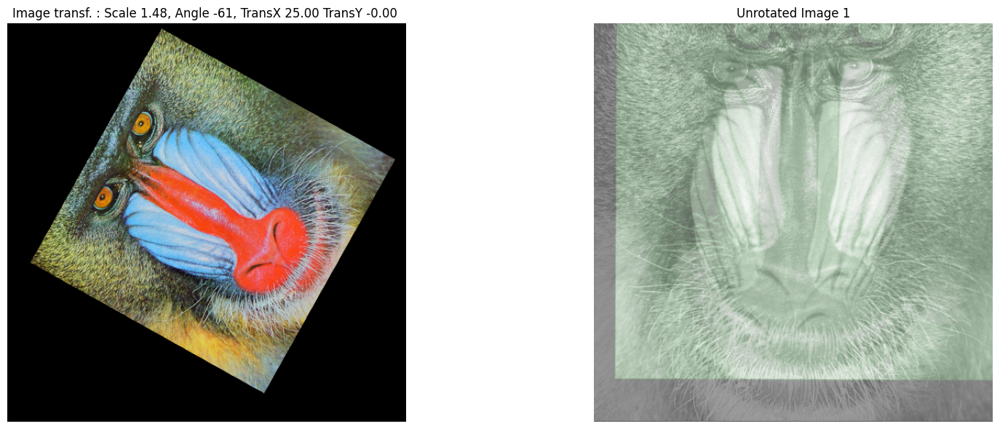

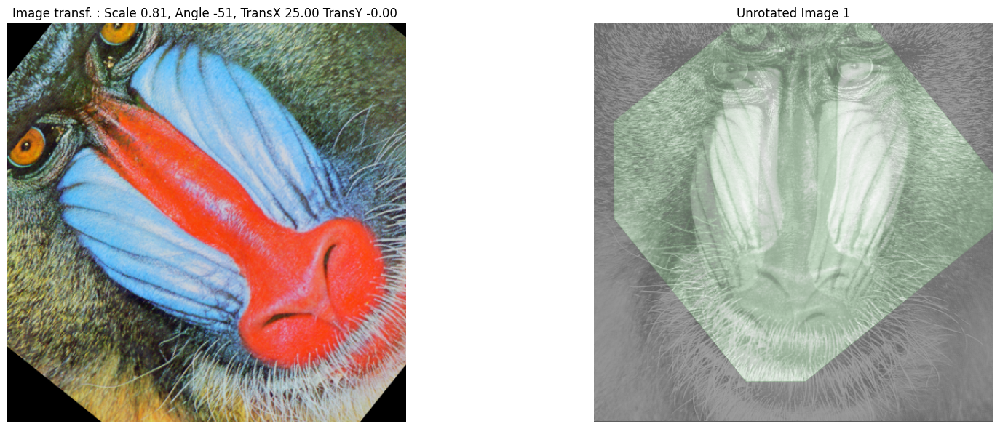

...

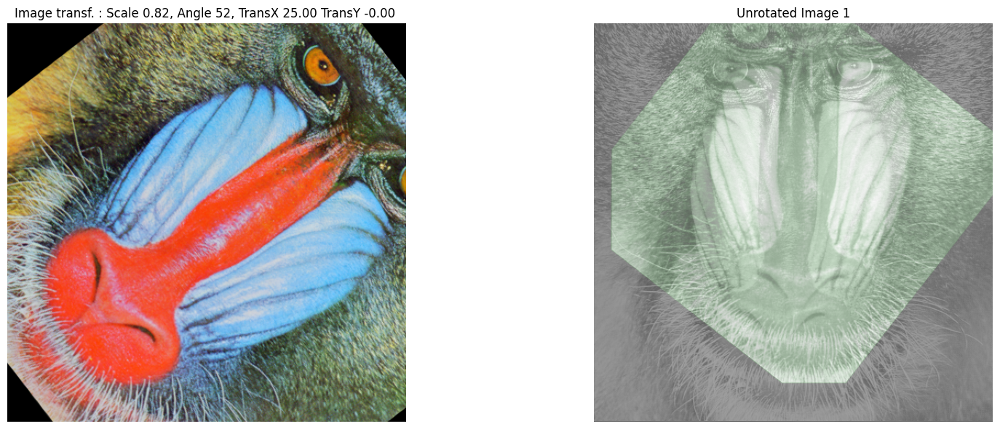

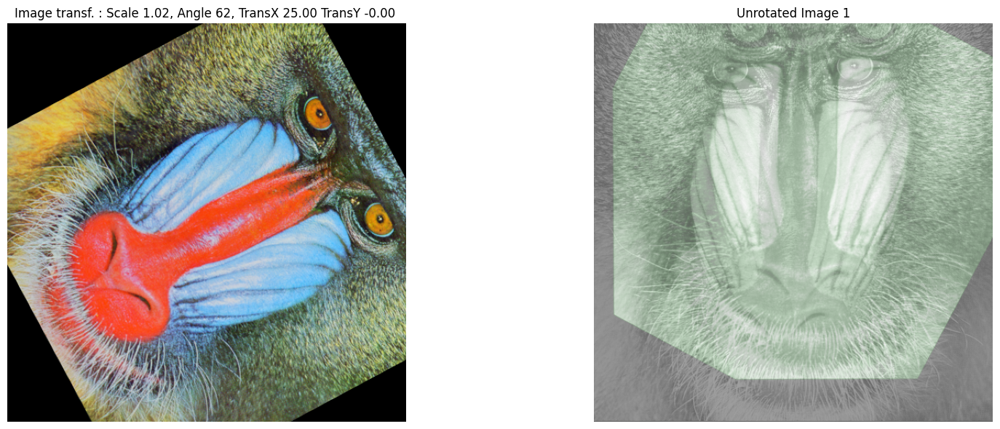

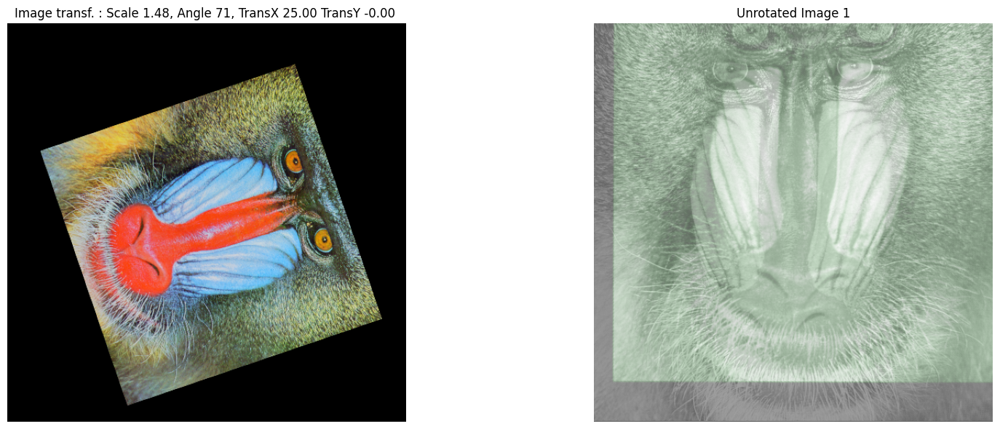

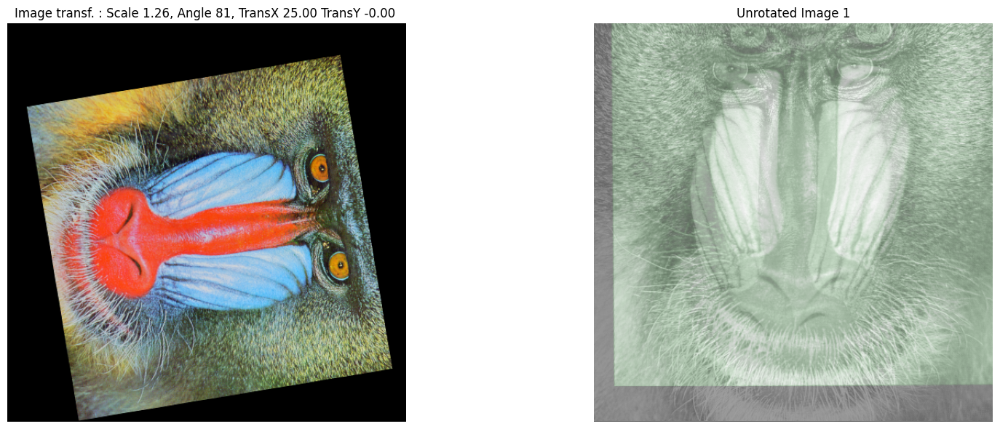

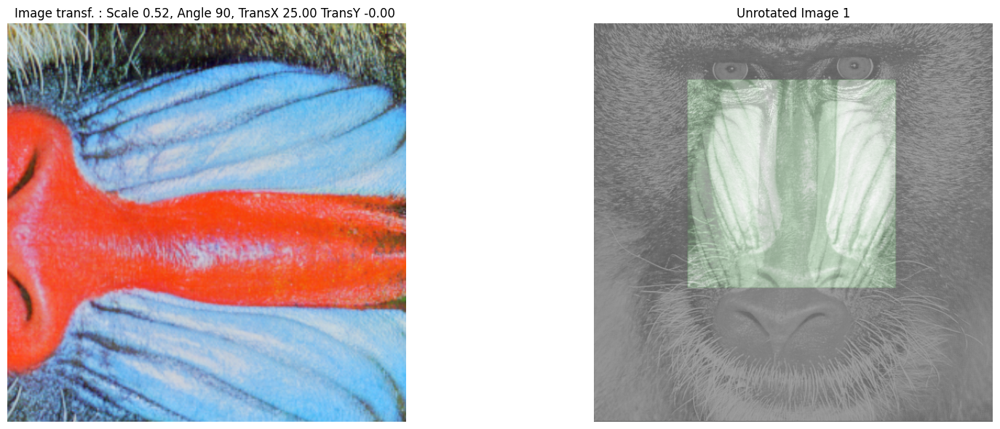

In [ ]:
from matplotlib.colors import LinearSegmentedColormap
def normalize(x):
    return (x-x.min())/(x.max()-x.min())    

gtScale = torch.rand(N)+0.5
gtAngle = (torch.linspace(-89,90,N)).float()
trans_x = 0*(torch.rand(N)-1)*2
trans_x = 25*torch.ones(N)
trans_y = 0*(torch.rand(N)-1)*2
bimageTransf = rigid_transform(bimage, gtScale, trans_x, trans_y, gtAngle)
bimageFdMagLogPol,bimageTransfFdMagLogPol =cart2pol(apply_highpass(fft2d(bimage), bhp))[...,:180,:], cart2pol(apply_highpass(fft2d(bimageTransf), bhp))[...,:180,:]
pc = phase_correlation(bimageFdMagLogPol, bimageTransfFdMagLogPol)
estScale, estAmbiguousAngle = estimate_rot_scale_parameters(pc, radius)
invEstScale, invEstAmbiguousAngle = inverse_rot_scale_parameters(estScale, estAmbiguousAngle)
bimageTransfUnrot1 = rigid_transform(bimageTransf, invEstScale, torch.zeros_like(invEstScale), torch.zeros_like(invEstScale),invEstAmbiguousAngle)
pcUnrot = phase_correlation(bimage, bimageTransfUnrot1).sum(-3)
estimatedParameters = estimate_all_parameters(pcUnrot,x_center,y_center, estScale, estAmbiguousAngle)
print("Estimated Parameters", estimatedParameters)
bimageTransfPredicted = rigid_transform(bimageTransfUnrot1, torch.ones_like(invEstScale), 2*estimatedParameters[...,0], 2*estimatedParameters[...,1],torch.zeros_like(invEstAmbiguousAngle))

gray_to_green = LinearSegmentedColormap.from_list("gray_to_green", ["gray", "green"])

for i in range(N):
    fig, axes = plt.subplots(1, 2, figsize=(18, 6))
    im0 = axes[0].imshow(bimageTransf[i].moveaxis(0,-1))
    axes[0].set_title(f"Image transf. : Scale {estScale[i].item():.2f}, Angle {estAmbiguousAngle[i].item()}, TransX {trans_x[i].item():.2f} TransY {trans_y[i].item():.2f} ")
    axes[0].axis('off')
    axes[1].imshow(bimageTransfPredicted[i].mean(0), cmap=gray_to_green, alpha=normalize(1 - bimageTransfPredicted[i].mean(0)))
    axes[1].imshow(bimage[i].mean(0), cmap='gray', alpha=0.3)
    axes[1].set_title("Unrotated Image 1")
    axes[1].axis('off')
    plt.tight_layout()
    plt.show()


# assert (estScale-gtScale).abs().max()<0.03
# assert (estAmbiguousAngle-gtAngle).abs().max()%180<=3, (estAmbiguousAngle-gtAngle).abs().max()
# print(estimatedParameters)


In [17]:
img = bimageTransfPredicted[i]
# Compute mean intensity for alpha (invert so low values are opaque)
alpha = 1 - img.mean(0)
# Stack alpha as a new channel
img_rgba = torch.cat([img, alpha.unsqueeze(0)], dim=0)

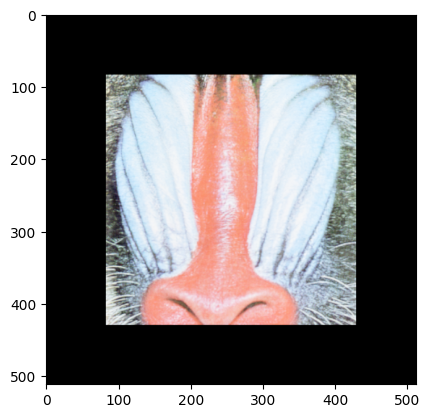

In [20]:
plt.imshow(img_rgba.moveaxis(0, -1).cpu())